# Importing Necessary Libraries

In [ ]:
import os
import numpy as np
import pandas as pd

#from raceplotly.plots import barplot
import missingno
import seaborn as sns
import plotly.express as px 
import plotly.graph_objects as go
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
from scipy import stats
#import spotipy as sp

import warnings
warnings.filterwarnings("ignore")

# Importing Dataset & Cleaning

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Data Mining/Spotify Recommendation System/data/data.csv')
df_year = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Data Mining/Spotify Recommendation System/data/data_by_year.csv')
df_genre = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Data Mining/Spotify Recommendation System/data/data_by_genres.csv')

In [ ]:
#df[(np.abs(stats.zscore(df)) < 3).all(axis=1)]

## Describing the dataset

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [ ]:
df['year'] = pd.Categorical(df['year'])
df['key'] = pd.Categorical(df['key'])
df['mode'] = pd.Categorical(df['mode'])

In [ ]:
round(df.describe(include = 'all'),2)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
count,170653.00,170653.0,170653.00,170653,170653.00,170653.00,170653.00,170653.00,170653,170653.00,170653.0,170653.00,170653.00,170653.0,170653,170653.00,170653,170653.00,170653.00
unique,NaN,100.0,NaN,34088,NaN,NaN,NaN,NaN,170653,NaN,12.0,NaN,NaN,2.0,133638,NaN,11244,NaN,NaN
top,NaN,2018.0,NaN,['Эрнест Хемингуэй'],NaN,NaN,NaN,NaN,4BJqT0PrAfrxzMOxytFOIz,NaN,0.0,NaN,NaN,1.0,White Christmas,NaN,1945,NaN,NaN
freq,NaN,2103.0,NaN,1211,NaN,NaN,NaN,NaN,1,NaN,21600.0,NaN,NaN,120635.0,73,NaN,1446,NaN,NaN
mean,0.53,NaN,0.50,NaN,0.54,230948.31,0.48,0.08,NaN,0.17,NaN,0.21,-11.47,NaN,NaN,31.43,NaN,0.10,116.86
std,0.26,NaN,0.38,NaN,0.18,126118.41,0.27,0.28,NaN,0.31,NaN,0.17,5.70,NaN,NaN,21.83,NaN,0.16,30.71
min,0.00,NaN,0.00,NaN,0.00,5108.00,0.00,0.00,NaN,0.00,NaN,0.00,-60.00,NaN,NaN,0.00,NaN,0.00,0.00
25%,0.32,NaN,0.10,NaN,0.42,169827.00,0.26,0.00,NaN,0.00,NaN,0.10,-14.62,NaN,NaN,11.00,NaN,0.03,93.42
50%,0.54,NaN,0.52,NaN,0.55,207467.00,0.47,0.00,NaN,0.00,NaN,0.14,-10.58,NaN,NaN,33.00,NaN,0.04,114.73
75%,0.75,NaN,0.89,NaN,0.67,262400.00,0.70,0.00,NaN,0.10,NaN,0.26,-7.18,NaN,NaN,48.00,NaN,0.08,135.54


In [ ]:
df_genre.info() #checking datatype of columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [ ]:
#converting numeric to categorical
df_genre['genres'] = pd.Categorical(df_genre['genres'])
df_genre['key'] = pd.Categorical(df_genre['key'])
df_genre['mode'] = pd.Categorical(df_genre['mode'])

In [ ]:
round(df_genre.describe(include = 'all'),2)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,2973.0,2973,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.00,2973.0
unique,2.0,2973,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0
top,1.0,21st century classical,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
freq,2477.0,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,694.0
mean,NaN,NaN,0.40,0.54,251720.85,0.56,0.21,0.19,-10.51,0.08,119.02,0.49,39.92,NaN
std,NaN,NaN,0.32,0.15,94656.86,0.23,0.27,0.09,5.37,0.08,17.47,0.20,16.75,NaN
min,NaN,NaN,0.00,0.06,30946.00,0.00,0.00,0.02,-41.82,0.02,47.14,0.00,0.00,NaN
25%,NaN,NaN,0.12,0.44,206378.85,0.40,0.00,0.14,-12.43,0.04,109.20,0.35,32.49,NaN
50%,NaN,NaN,0.32,0.55,237545.34,0.60,0.08,0.18,-9.22,0.06,119.19,0.50,43.06,NaN
75%,NaN,NaN,0.67,0.65,277272.00,0.73,0.34,0.22,-6.92,0.09,127.51,0.64,51.14,NaN


In [ ]:
df_year.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [ ]:
#converting numeric to categorical
df_year['year'] = pd.Categorical(df_year['year'])
df_year['key'] = pd.Categorical(df_year['key'])
df_year['mode'] = pd.Categorical(df_year['mode'])

In [ ]:
round(df_year.describe(include = 'all'),2)

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,100.0,100.0,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.0
unique,1.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0
top,1.0,1921.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
freq,100.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,34.0
mean,NaN,NaN,0.56,0.54,227296.75,0.45,0.19,0.21,-11.97,0.11,116.02,0.53,27.38,NaN
std,NaN,NaN,0.28,0.05,25630.05,0.16,0.12,0.02,3.11,0.08,5.67,0.06,20.70,NaN
min,NaN,NaN,0.22,0.41,156881.66,0.21,0.02,0.17,-19.28,0.05,100.88,0.38,0.14,NaN
25%,NaN,NaN,0.29,0.50,210889.19,0.28,0.10,0.20,-14.19,0.06,111.72,0.50,3.30,NaN
50%,NaN,NaN,0.46,0.54,235520.85,0.50,0.13,0.21,-11.77,0.09,117.46,0.54,33.62,NaN
75%,NaN,NaN,0.86,0.57,247702.74,0.60,0.28,0.22,-9.95,0.10,120.61,0.57,44.94,NaN


## Searching for Missing Values

Text(0.5, 1.0, 'Missing records in df')

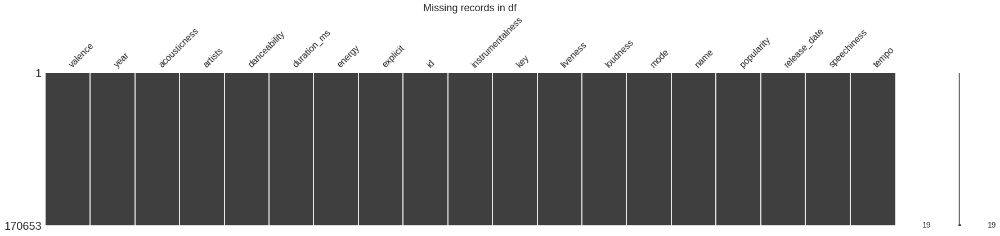

In [ ]:
missingno.matrix(df, figsize = (30,5))
plt.title("Missing records in df", fontsize = '18')

Text(0.5, 1.0, 'Missing records in df_year')

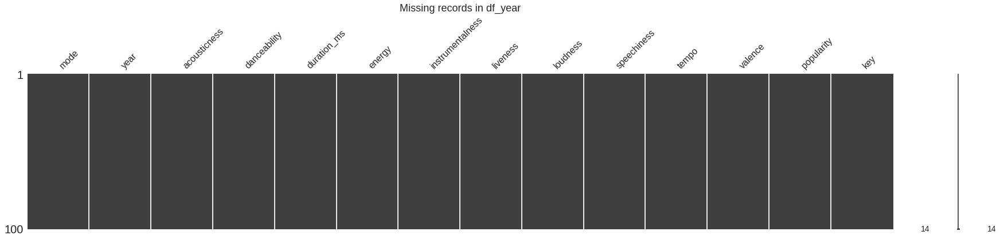

In [ ]:
missingno.matrix(df_year, figsize = (30,5))
plt.title("Missing records in df_year", fontsize = '18')

Text(0.5, 1.0, 'Missing records in df_genre')

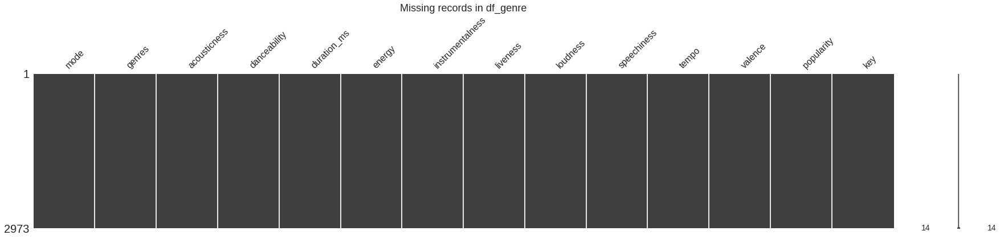

In [ ]:
missingno.matrix(df_genre, figsize = (30,5))
plt.title("Missing records in df_genre", fontsize = '18')

#Exploratory Data Analysis

## Basic Analysis

In [ ]:
df.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [ ]:
year_count = df['year'].value_counts(ascending = False).reset_index()
year_count.rename(columns = {'index':'year', 'year':'count'}, inplace = True) 
year_count['year'] = year_count.year.astype('int32')
year_count.sort_values(by=['year'], inplace = True)
year_count['year'] = pd.to_datetime(year_count.year, format='%Y')
year_count = year_count.set_index('year')
year_count = year_count.resample('10AS').sum()
year_count =  year_count.reset_index()


In [ ]:
fig = px.bar(year_count, x="year", y='count', title="NO. OF SONGS IN THE DATASET BY YEARS",
                 width=1000, height=500)
fig.show(renderer="colab") 

In [ ]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(df_year, x='year', y=sound_features, title="MUSIC PROFILE THROUGHOUT THE YEARS",
                 width=1000, height=500)
fig.add_vrect(x0=1966, x1=1966, line_width=1, line_color="red")

fig.show(renderer="colab")

In [ ]:
top10_genres = df_genre.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group', title = 'TOP 10 GENRES AND THEIR MUSIC PROFILE COMPOSITION',
                 width=1000, height=500)
fig.show(renderer="colab")

In [ ]:
df_corr = round(df.corr(),2)
fig = px.imshow(df_corr, text_auto=True, title='CORRELATION HEATMAP (df)')
fig.update_layout(
    autosize=False,
    width=800,
    height=800)
fig.show(renderer="colab")

In [ ]:
df.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


## PCA to Analyze Songs

In [ ]:
chosen = ["energy", "liveness", "tempo", "valence", "loudness", "speechiness", "acousticness", "danceability", "instrumentalness"]
text1 = df["artists"] + " - " + df["name"]
text2 = text1.values

X = df[chosen].values
y = df["danceability"].values

scaler = MinMaxScaler()
X = scaler.fit_transform(X)

pca = PCA(n_components=3)
pca.fit(X)

X = pca.transform(X)

In [ ]:
trace = go.Scatter3d(
    x=X[:,0],
    y=X[:,1],
    z=X[:,2],
    text=text2,
    mode="markers",
    marker=dict(
        size=8,
        color=y,
        colorbar=dict(
            title="Danceability"
        )
    )
)

fig = go.Figure(data=[trace])

fig.update_layout(
    title='WHICH SONGS ARE DANCEABLE?', 
    autosize=False,
    width=1200, 
    height=900,
    margin=dict(l=65, r=50, b=65, t=90),
    scene=dict(
        xaxis_title="Principal Component 1",
        yaxis_title="Principal Component 2",
        zaxis_title="Principal Component 3",
    ),
)

fig.show(renderer="colab")


# Data Mining

## Clustering Genre and applying T-SNE to get embeddings

In [ ]:
df_genre = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Data Mining/Spotify Recommendation System/data/data_by_genres.csv')

In [ ]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=10, 
                                   verbose=False))
                                 ], verbose=False)

X_genre = df_genre.select_dtypes(np.number)
number_cols = list(X_genre.columns)
song_cluster_pipeline.fit(X_genre)
song_cluster_labels = song_cluster_pipeline.predict(X_genre)
df_genre['cluster_label'] = song_cluster_labels

In [ ]:
from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X_genre)
projection1 = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection1['genres'] = df_genre['genres']
projection1['cluster'] = df_genre['cluster_label']


In [ ]:
projection1.head()

In [ ]:
projection1["cluster"] = projection1["cluster"].astype(str)
fig = px.scatter(
    projection1, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'],width=1200,
    height=800)

fig.update_layout(
    title='T-SNE over Genre Data - 2 Dimensions', 
    autosize=False,
    width=1200, 
    height=800,
    margin=dict(l=65, r=50, b=65, t=90),
    scene=dict(
        xaxis_title="t-sne 1",
        yaxis_title="t-sne 2"
    )
)
fig.show()

In [ ]:
from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=3, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X_genre)
projection2 = pd.DataFrame(columns=['x', 'y','z'], data=genre_embedding)
projection2['genres'] = df_genre['genres']
projection2['cluster'] = df_genre['cluster_label']

In [ ]:
projection2.head()

In [ ]:
projection2["cluster"] = projection2["cluster"].astype(str)
fig = px.scatter_3d(projection2, x='x', y='y', z='z',
              color='cluster', hover_data=["genres"])

fig.update_layout(
    title='T-SNE over Genre Data - 3 Dimensions', 
    autosize=False,
    width=1200, 
    height=800,
    margin=dict(l=65, r=50, b=65, t=90),
    scene=dict(
        xaxis_title="t-sne 1",
        yaxis_title="t-sne 2",
        zaxis_title="t-sne 3",
    )
)
fig.show()

## Clustering Songs and applying PCA to get embeddings

In [ ]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = df.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
df['cluster_label'] = song_cluster_labels

In [ ]:
df

In [ ]:
'''from sklearn import metrics
k = metrics.silhouette_score(df.select_dtypes(np.number), df['cluster_label'], metric='euclidean')
print("Silhouette Co-efficient: " + str(round(k,2)))
dunn = metrics.davies_bouldin_score(df.select_dtypes(np.number), df['cluster_label'])
print("Davis Bouldin Score: " + str(round(k,2)))'''

In [ ]:
'''# Silhouette Score for K means
from yellowbrick.cluster import KElbowVisualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(18,22), metric='silhouette', timings= True, size=(1000, 500))
visualizer.fit(X.iloc[:50000, :-1])      
visualizer.show()'''

In [ ]:
'''from yellowbrick.cluster import KElbowVisualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(10,22), metric='calinski_harabasz', timings= True, size=(1000, 500),locate_elbow=False)
visualizer.fit(X.iloc[:50000, :-1])      
visualizer.show()'''

In [ ]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = df['name']
projection['cluster'] = df['cluster_label']


In [ ]:
projection["cluster"] = projection["cluster"].astype(str)
fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])

fig.update_layout(
    title='PCA over Song Data - 2 Dimensions', 
    autosize=False,
    width=1200, 
    height=800,
    margin=dict(l=65, r=50, b=65, t=90),
    scene=dict(
        xaxis_title="Principal Component 1",
        yaxis_title="Principal Component 2",
    )
)
fig.show()

In [ ]:
projection

#Recommendation System

In [ ]:
#!pip install spotipy
%env SPOTIFY_CLIENT_ID=b4a54486fe1f4bfa84180d00a67afd61
%env SPOTIFY_CLIENT_SECRET=9435f0be3b2848898e27f061cc496266

In [ ]:
import spotipy as sp
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

#For authentication purpose
#sp_call = sp.Spotify(auth_manager=SpotifyClientCredentials(client_id=os.environ["SPOTIFY_CLIENT_ID"], client_secret=os.environ["SPOTIFY_CLIENT_SECRET"]))
sp_call = sp.Spotify(auth_manager=SpotifyClientCredentials(client_id="b4a54486fe1f4bfa84180d00a67afd61", client_secret="9435f0be3b2848898e27f061cc496266"))


In [ ]:
def find_song(name, year):
    song_data = defaultdict()
    results = sp_call.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp_call.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [ ]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

'''number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']'''

number_cols = ['valence',
 'acousticness',
 'danceability',
 'duration_ms',
 'energy',
 'explicit',
 'instrumentalness',
 'liveness',
 'loudness',
 'popularity',
 'speechiness',
 'tempo']

def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)
    


def unnest_dictionary(song_list_dict):
    
    flattened_dict = defaultdict()
    for key in song_list_dict[0].keys():
        flattened_dict[key] = []
    
    for dictionary in song_list_dict:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = unnest_dictionary(song_list)
    
    #Get mean vector of input song list
    song_center = get_mean_vector(song_list, spotify_data)

    #get scaler step from pipeline
    scaler = song_cluster_pipeline[0]

    #scale dataset vector
    scaled_data = scaler.transform(spotify_data[number_cols])

    #scale input vector
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))

    #calculate cosine similarity
    distances = cdist(scaled_song_center, scaled_data, 'cosine')

    #sort by similarity and select top n vectors
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    #fetch recommended songs based on index
    recommended_songs = spotify_data.iloc[index]
    recommended_songs = recommended_songs[~recommended_songs['name'].isin(song_dict['name'])]
    return recommended_songs[metadata_cols].to_dict(orient='records')

In [ ]:
recommend_songs([{'name': 'Come As You Are', 'year':1991},
                {'name': 'Smells Like Teen Spirit', 'year': 1991},
                {'name': 'Lithium', 'year': 1992},
                {'name': 'All Apologies', 'year': 1993},
                {'name': 'Stay Away', 'year': 1993}],  df)

In [ ]:
recommend_songs([{'name': 'For The Night (feat. Lil Baby & DaBaby)', 'year':2020},
                {'name': 'Mood (feat. iann dior)', 'year': 2020},
                {'name': 'WAP (feat. Megan Thee Stallion)', 'year': 2020},
                {'name': 'positions', 'year': 2020},
                {'name': 'Blinding Lights	', 'year': 2020}],  df)

In [ ]:
df[(df['year'] == 2020) & (df['popularity'] >= 95)]

#END